# Smart Water Analytics

Este proyecto dará solución al problema propuesto por la competición homonima en Kaggle.  
El principal objetivo de la competición es encontrar un modelo que prediga o determine que features son relevantes para la disponibilidad de agua, en cada tipo de cuerpo de agua. Los tipos de cuerpos de agua son. 
- acuíferos 
- ríos
- lagos. 
- manantiales

El outcome deseado es tener cuatro modelos predictores, uno por cada tipo de cuerpo de agua (acuíferos, cascadas, ríos y lagos).

# 1. Preparación del Entorno. 

Antes de cargar los datos, se importarán las librerías que se requerirán:

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np


# 2. Carga de Datos y EDA inicial. 

## Carga de Datos. 

### Acuíferos. 

In [2]:
# Aquifer Auser
df_aa = pd.read_csv("../data/raw/Aquifer_Auser.csv")
df_aa.head()


,Date,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
0,05/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,06/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,10.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,07/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.2,0.0,10.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,08/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,13.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,09/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,12.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
df_aa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8154 entries, 0 to 8153
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Date                                     8154 non-null   object 
 1   Rainfall_Gallicano                       5295 non-null   float64
 2   Rainfall_Pontetetto                      5295 non-null   float64
 3   Rainfall_Monte_Serra                     5289 non-null   float64
 4   Rainfall_Orentano                        5295 non-null   float64
 5   Rainfall_Borgo_a_Mozzano                 5295 non-null   float64
 6   Rainfall_Piaggione                       4930 non-null   float64
 7   Rainfall_Calavorno                       5295 non-null   float64
 8   Rainfall_Croce_Arcana                    5295 non-null   float64
 9   Rainfall_Tereglio_Coreglia_Antelminelli  5295 non-null   float64
 10  Rainfall_Fabbriche_di_Vallico            5295 no

In [27]:
df_aa.describe()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
count,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,...,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000,8154.000000
mean,3.213613,2.269855,2.542065,2.045965,2.973461,2.390618,2.973412,1.850552,2.716286,3.845793,...,11.202079,10.971358,15.501134,-6466.684269,-11315.714300,-8196.439062,-1633.002615,-1378.401605,0.278503,-0.156993
std,11.815080,8.216133,8.908824,7.207398,10.520561,8.683849,10.276922,7.568606,9.192451,13.420925,...,6.903190,8.708626,7.138789,4675.817303,7613.770828,5572.587869,2613.341633,2301.150394,0.224481,0.741015
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-7.850000,-2.850000,-3.300000,-13883.225810,-18601.920000,-14438.304000,-7757.258065,-9497.774194,0.000000,-1.190000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,5.650000,0.000000,9.750000,-10326.000000,-16799.659350,-12537.670710,-4670.903226,-3521.931034,0.120000,-0.960000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,11.000000,10.875000,15.400000,-7905.670000,-15887.858060,-11182.752000,0.000000,0.000000,0.230000,0.000000
75%,0.200000,0.000000,0.200000,0.200000,0.000000,0.000000,0.200000,0.200000,0.200000,0.200000,...,16.700000,18.550000,21.600000,0.000000,0.000000,0.000000,0.000000,0.000000,0.380000,0.210000
max,318.800000,146.600000,152.200000,108.800000,176.600000,140.800000,209.000000,285.000000,147.200000,197.000000,...,29.500000,30.750000,31.050000,0.000000,0.000000,0.000000,0.000000,0.000000,2.170000,3.690000


In [4]:
# Aquifer Doganella
df_ad = pd.read_csv("../data/raw/Aquifer_Doganella.csv")
df_ad.head()

,Date,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
0,01/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.30,8.60
1,02/01/2004,0.2,0.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.70,6.25
2,03/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.40,9.80
3,04/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.35,5.95
4,05/01/2004,0.2,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,5.85


In [5]:
df_ad.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6026 entries, 0 to 6025
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Date                          6026 non-null   object 
 1   Rainfall_Monteporzio          5399 non-null   float64
 2   Rainfall_Velletri             5374 non-null   float64
 3   Depth_to_Groundwater_Pozzo_1  2537 non-null   float64
 4   Depth_to_Groundwater_Pozzo_2  2736 non-null   float64
 5   Depth_to_Groundwater_Pozzo_3  2774 non-null   float64
 6   Depth_to_Groundwater_Pozzo_4  2374 non-null   float64
 7   Depth_to_Groundwater_Pozzo_5  2508 non-null   float64
 8   Depth_to_Groundwater_Pozzo_6  2428 non-null   float64
 9   Depth_to_Groundwater_Pozzo_7  2311 non-null   float64
 10  Depth_to_Groundwater_Pozzo_8  2551 non-null   float64
 11  Depth_to_Groundwater_Pozzo_9  2339 non-null   float64
 12  Volume_Pozzo_1                1356 non-null   float64
 13  Vol

In [28]:
df_ad.describe()

,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,Depth_to_Groundwater_Pozzo_8,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
count,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,...,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000,6026.000000
mean,2.592665,2.817856,-15.547498,-43.017851,-51.391700,-38.696253,-42.682030,-36.936929,-36.747134,-40.574434,...,344.147717,774.898874,724.035232,796.145574,1620.119909,562.280938,826.129382,731.187946,10.193229,11.327748
std,8.211054,8.474295,19.393266,47.249178,55.708176,48.022220,50.611792,44.989945,46.606660,47.388345,...,841.399859,1481.588631,1436.789845,1511.802473,3096.775366,1089.292525,1578.297092,1398.170771,8.241925,8.801152
min,0.000000,0.000000,-59.500000,-112.500000,-117.800000,-108.660000,-109.890000,-99.480000,-97.430000,-107.500000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.620000,-0.270000
25%,0.000000,0.000000,-33.417500,-93.080000,-111.050000,-97.430000,-100.590000,-90.960000,-95.237500,-94.970000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.100000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.860000,11.500000
75%,0.400000,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.110000,18.667500
max,112.600000,106.600000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,4171.280000,4030.270000,5378.800000,4076.100000,8360.210000,3427.420000,4341.710000,4336.780000,30.400000,31.900000


In [6]:
# Aquifer Luco
df_al = pd.read_csv("../data/raw/Aquifer_Luco.csv")
df_al.head()

,Date,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
0,01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
1,02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,6.20,3.25,NaN,NaN,NaN
2,03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.25,0.95,NaN,NaN,NaN
3,04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.00,4.20,NaN,NaN,NaN
4,05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.90,6.55,NaN,NaN,NaN


In [7]:
df_al.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7487 entries, 0 to 7486
Data columns (total 22 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Date                                 7487 non-null   object 
 1   Rainfall_Simignano                   6822 non-null   float64
 2   Rainfall_Siena_Poggio_al_Vento       951 non-null    float64
 3   Rainfall_Mensano                     1722 non-null   float64
 4   Rainfall_Montalcinello               6525 non-null   float64
 5   Rainfall_Monticiano_la_Pineta        2205 non-null   float64
 6   Rainfall_Sovicille                   6657 non-null   float64
 7   Rainfall_Ponte_Orgia                 1260 non-null   float64
 8   Rainfall_Scorgiano                   3036 non-null   float64
 9   Rainfall_Pentolina                   2116 non-null   float64
 10  Rainfall_Monteroni_Arbia_Biena       3104 non-null   float64
 11  Depth_to_Groundwater_Podere_Ca

In [29]:
df_al.describe()

,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,Rainfall_Monteroni_Arbia_Biena,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
count,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,...,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000,7487.000000
mean,2.297502,0.288313,0.588968,2.159236,0.914705,2.028984,0.398317,1.306585,2.468652,0.991318,...,-1.500454,-1.215557,-1.695267,1.903954,3.343248,13.419761,13.593736,-43.095262,-39.632490,-36.264331
std,6.805813,2.280393,5.045307,7.039355,5.343848,6.689176,2.931120,13.658816,27.996719,5.034207,...,3.808045,3.256252,4.493209,5.602519,6.923075,7.249467,7.199626,75.970983,71.530109,66.740957
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-12.600000,-11.900000,-19.000000,-3.550000,-5.250000,-4.800000,-3.900000,-295.375015,-261.849600,-237.336612
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,7.950000,7.950000,-84.869524,-76.465920,-36.966140
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,13.200000,13.700000,0.000000,0.000000,0.000000
75%,0.400000,0.000000,0.000000,0.400000,0.000000,0.200000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,19.350000,19.650000,0.000000,0.000000,0.000000
max,87.800000,79.200000,313.000000,134.600000,171.000000,194.200000,90.000000,794.200000,620.800000,137.600000,...,0.000000,0.000000,0.000000,31.800000,31.850000,31.300000,29.450000,0.000000,0.000000,0.000000


In [8]:
# Aquifer Petrignano
df_ap = pd.read_csv("../data/raw/Aquifer_Petrignano.csv")
df_ap.head()

,Date,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
0,14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
1,15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
2,16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
3,17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
4,18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


In [9]:
df_ap.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5223 entries, 0 to 5222
Data columns (total 8 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Date                                  5223 non-null   object 
 1   Rainfall_Bastia_Umbra                 4199 non-null   float64
 2   Depth_to_Groundwater_P24              5168 non-null   float64
 3   Depth_to_Groundwater_P25              5184 non-null   float64
 4   Temperature_Bastia_Umbra              4199 non-null   float64
 5   Temperature_Petrignano                4199 non-null   float64
 6   Volume_C10_Petrignano                 5025 non-null   float64
 7   Hydrometry_Fiume_Chiascio_Petrignano  4199 non-null   float64
dtypes: float64(7), object(1)
memory usage: 326.6+ KB


In [30]:
df_ap.describe()

,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
count,5223.000000,5223.000000,5223.000000,5223.000000,5223.000000,5223.000000,5223.000000
mean,1.251446,-25.987157,-25.501078,12.083515,11.045453,-27942.287200,1.907371
std,4.719082,4.253695,3.891912,9.190191,8.799921,7245.320411,1.079977
min,0.000000,-34.470000,-33.710000,-3.700000,-4.200000,-45544.896000,0.000000
25%,0.000000,-28.195000,-27.590000,3.500000,2.100000,-31557.168000,1.900000
50%,0.000000,-25.960000,-25.520000,11.700000,10.700000,-28502.496000,2.300000
75%,0.000000,-23.765000,-23.400000,19.600000,18.150000,-25873.344000,2.600000
max,67.300000,0.000000,0.000000,33.000000,31.100000,0.000000,4.100000


### __Comparación de features entre acuíferos.__

En la siguiente tabla, se pueden observar las features en común para todos los acuíferos.

| Nombre de Acuífero | Features                                                            | Features en común                       |
|--------------------|---------------------------------------------------------------------|-----------------------------------------|
| Aquifer Auser      | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume<br>-Hidrometry | Date, Rainfall,Groundwater,Temperature,Volume |
| Aquifer Doganella  | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume                | Date, Rainfall,Groundwater,Temperature,Volume |
| Aquifer Luco       | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume.               | Date, Rainfall,Groundwater,Temperature,Volume |
| Aquifer Petrignano | -Date<br>-Rainfall<br>-Groundwater<br>-Temperature<br>-Volume<br>-Hidrometry | Date, Rainfall,Groundwater,Temperature,Volume |

Lo anterior, será útil para identificar sí es posible eliminar alguna variable que no es común en todos los acuíferos, en este caso, la variable Hidrometry.
También es útil para seleccionar la variable objetivo, la cual será __Volume__, pues el volumen es la cantidad total de agua subterránea que hay, siendo un buen indicador de la disponibilidad de agua en este tipo de cuerpo de agua.

## __EDA Inicial.__

### __Acuífero Auser.__
---

#### __Análisis Univariable.__ 

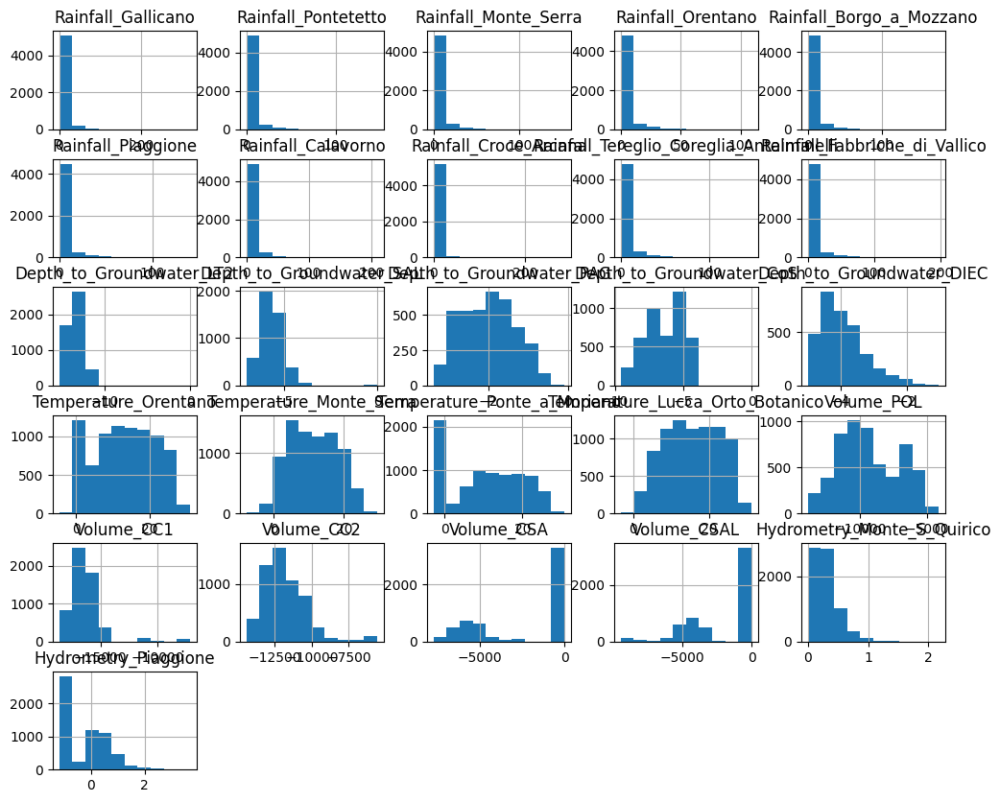

In [10]:
df_aa.hist(figsize=(12,10))
plt.show()

__Observaciones:__  
Como se puede observar en la visualización anterior, en algunas variables existen outliers, por lo que se analizará que tan viable es coservarlos.

#### __Análisis Bivariado.__ 

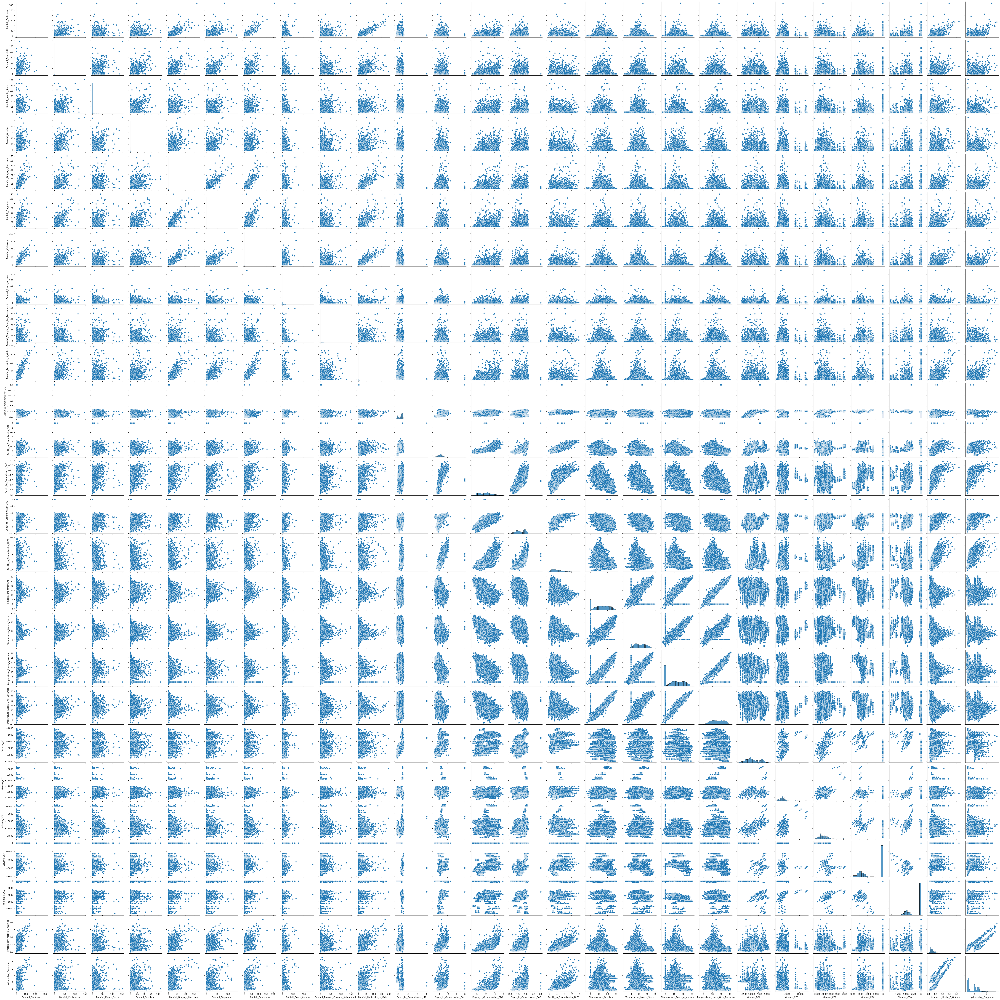

In [11]:
sns.pairplot(df_aa)

__Observaciones:__. 
Se puede observar que hay varias tendencias en los datos, se analizará de qué tipo son más adelante.

#### __Correlación:__

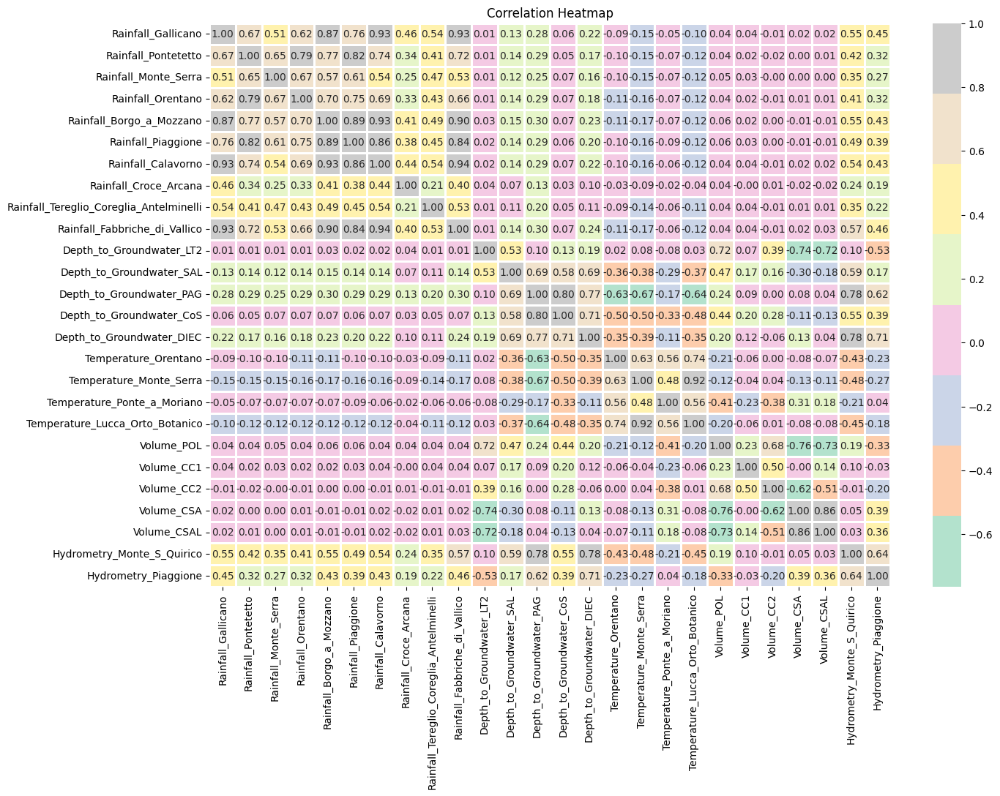

In [12]:
plt.figure(figsize=(15, 10))
df_wd = df_aa.drop(['Date'], axis=1)
sns.heatmap(df_wd.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Doganella__. 
---

#### __Análisis Univariable__

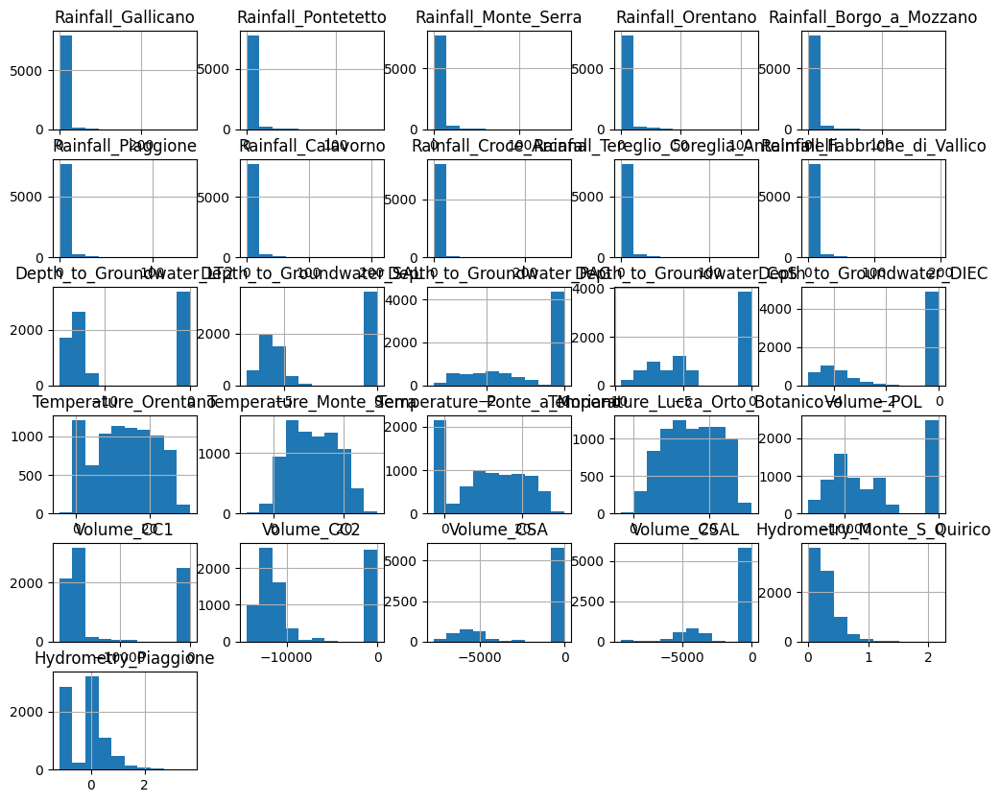

In [17]:
df_aa.hist(figsize=(12,10))
plt.show()

#### __Análisis Bivariado__

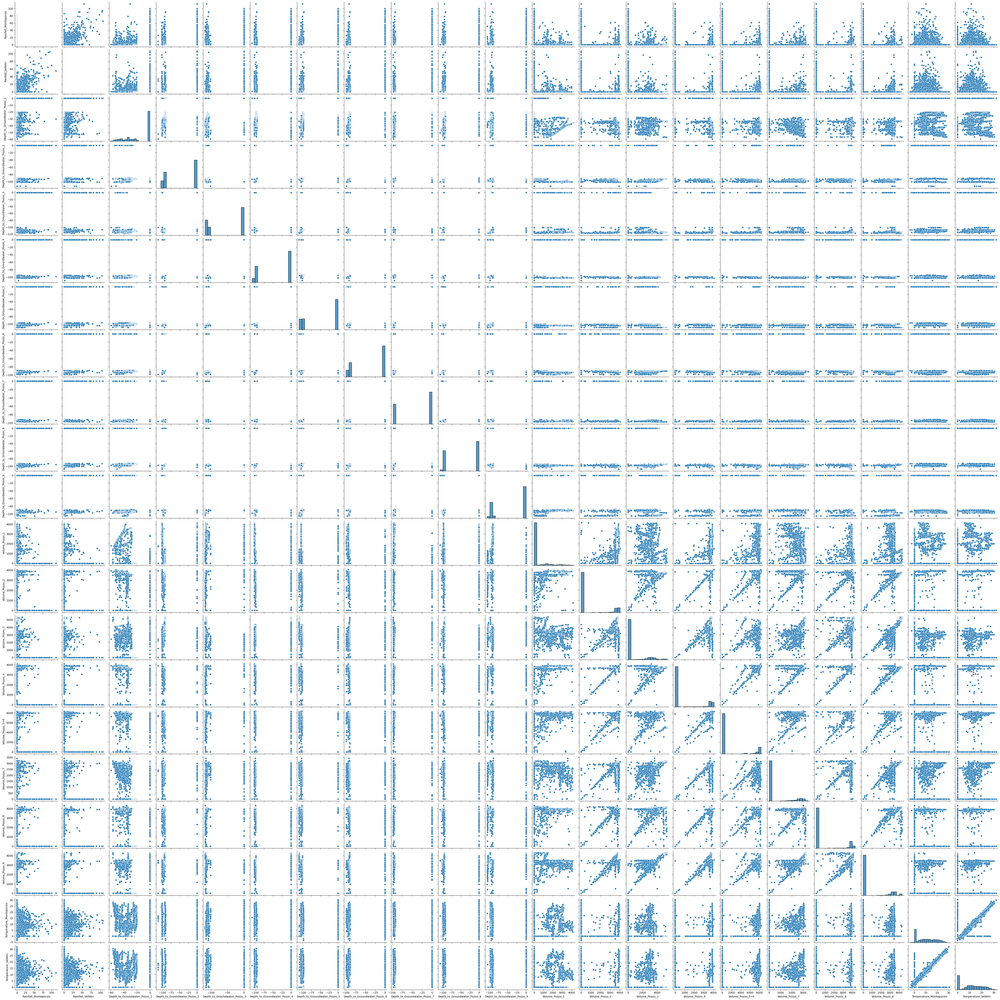

In [18]:
sns.pairplot(df_ad)

#### __Correlación__

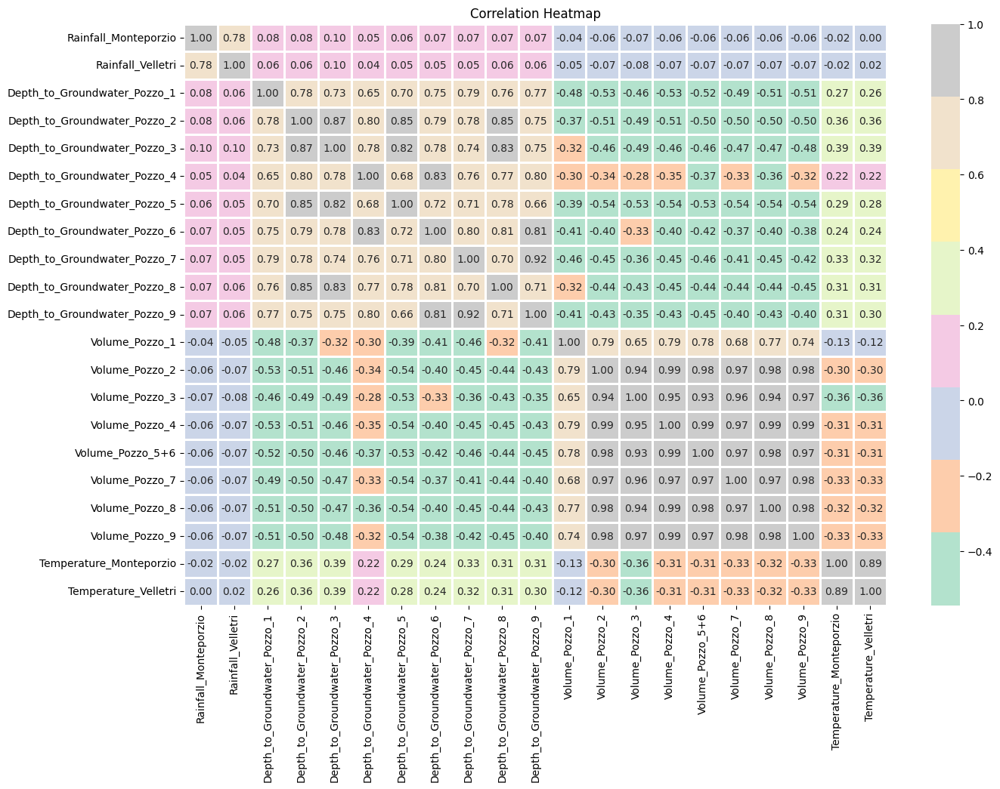

In [19]:
plt.figure(figsize=(15, 10))
df_wd_d = df_ad.drop(['Date'], axis=1)
sns.heatmap(df_wd_d.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Luco__. 
---

#### __Análisis Univariado__

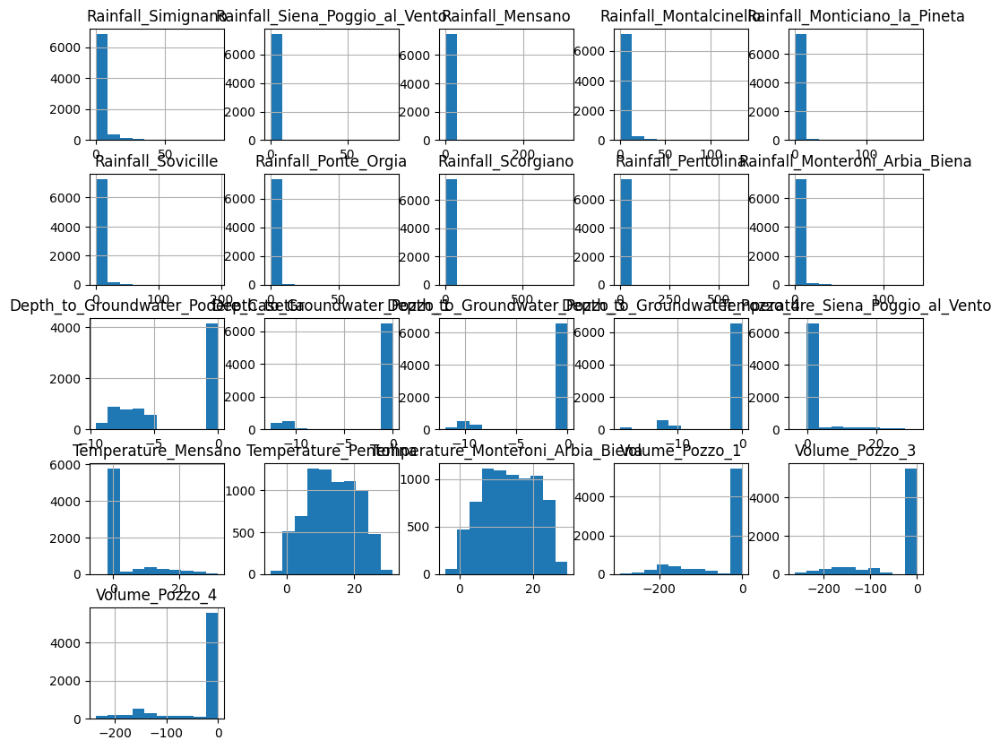

In [20]:
df_al.hist(figsize=(12,10))
plt.show()

#### __Análisis Bivariado.__

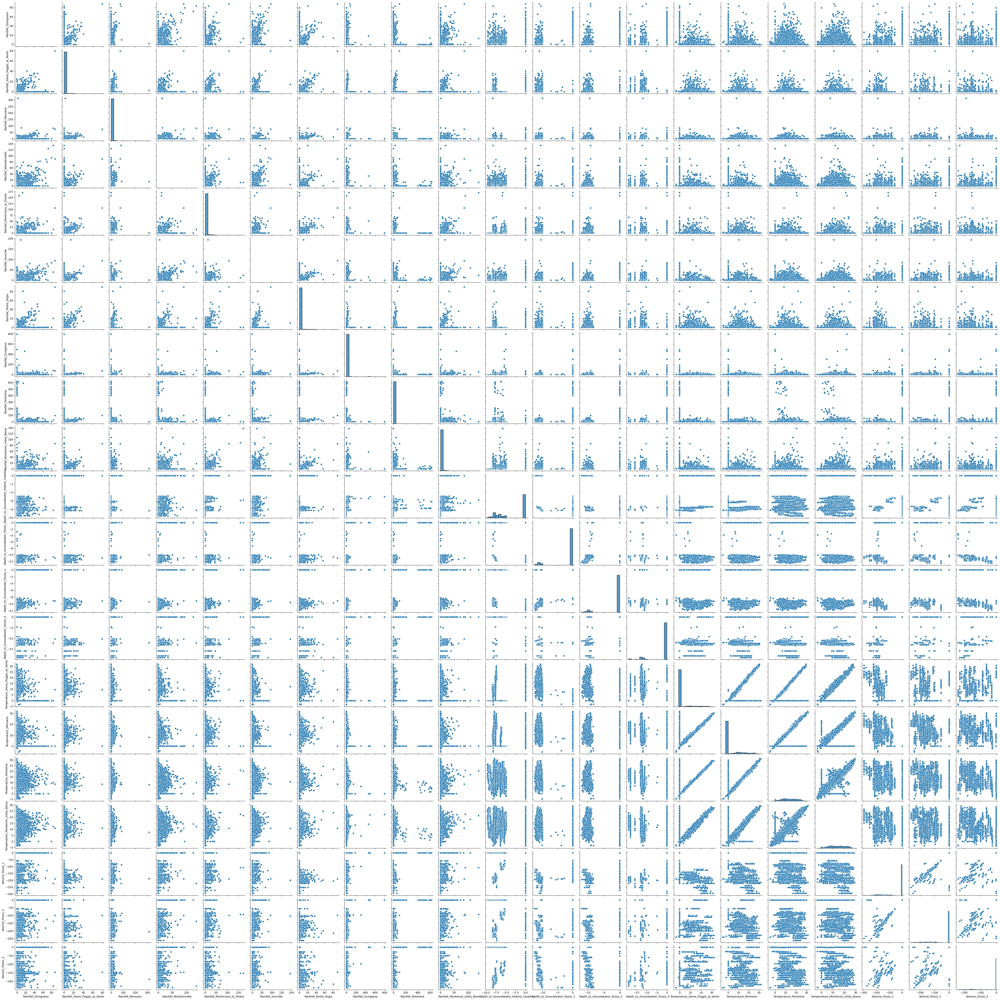

In [21]:
sns.pairplot(df_al)

#### __Correlación.__

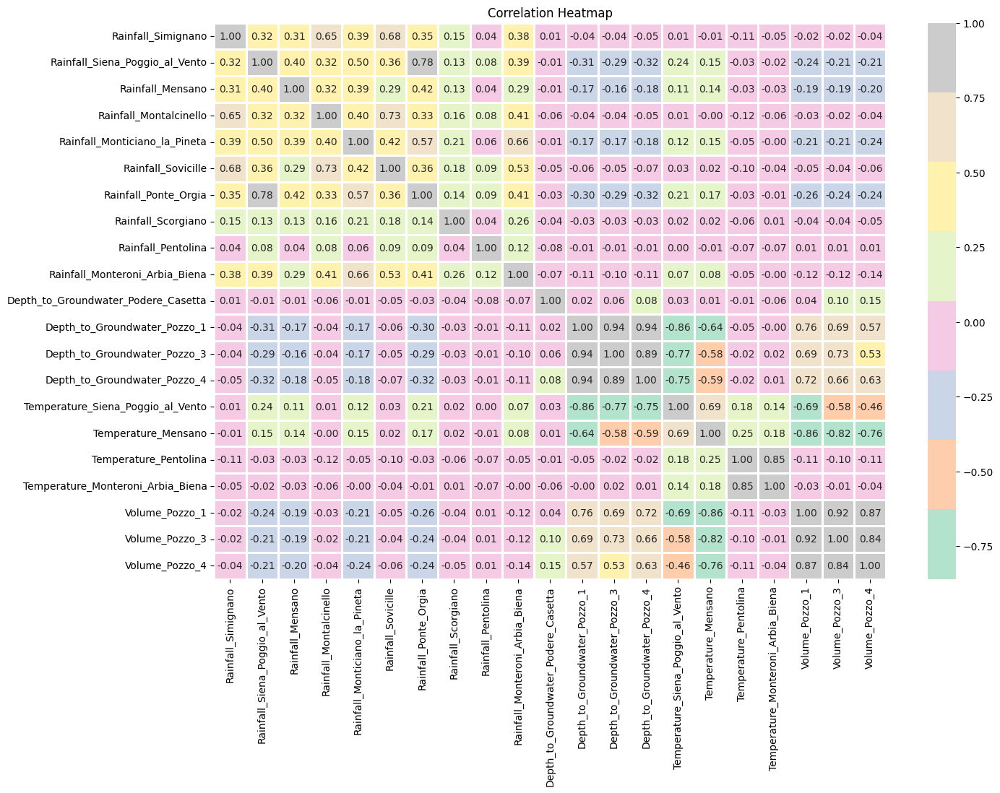

In [22]:
plt.figure(figsize=(15, 10))
df_wd_l = df_al.drop(['Date'], axis=1)
sns.heatmap(df_wd_l.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

### __Acuífero Petrignano__. 
---

#### __Análisis Univariado__

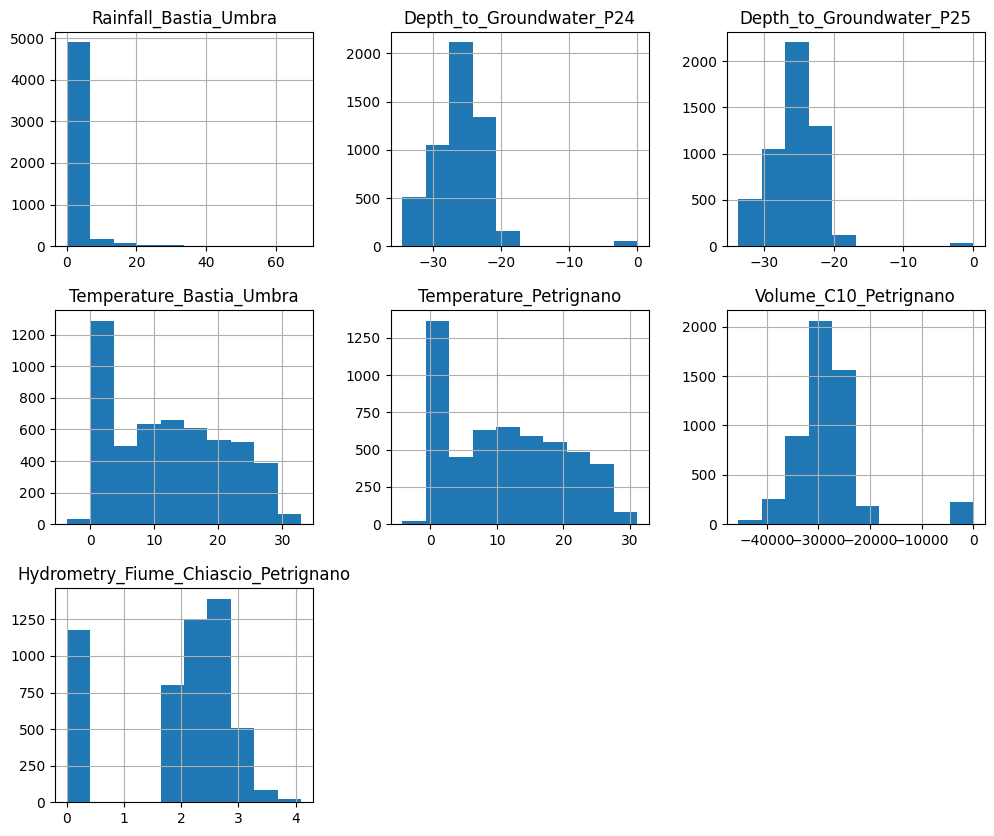

In [23]:
df_ap.hist(figsize=(12,10))
plt.show()

#### __Análisis Bivariado.__

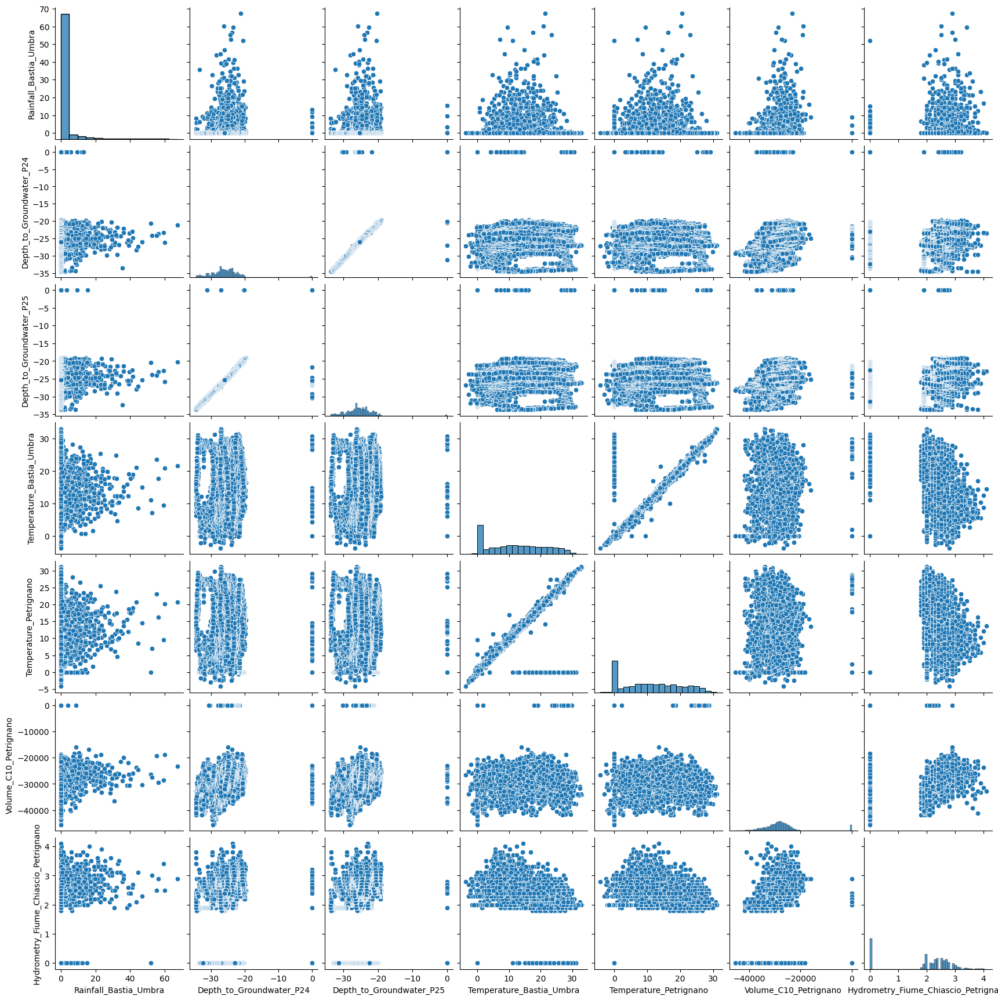

In [24]:
sns.pairplot(df_ap)

#### __Correlación.__

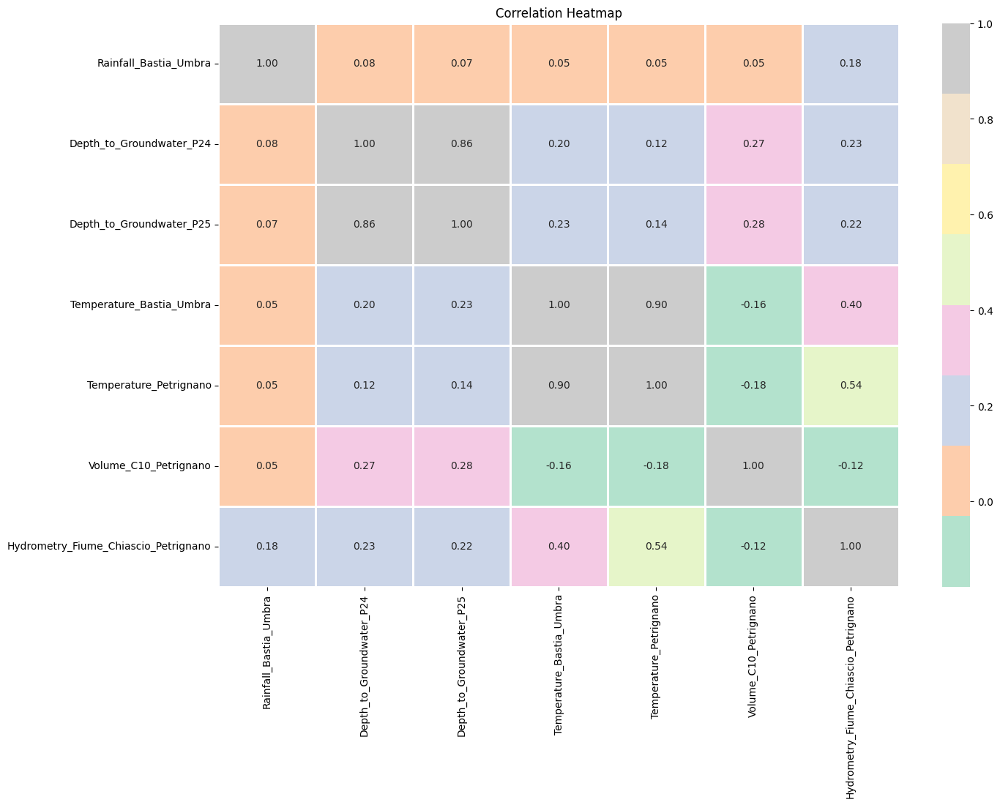

In [26]:
plt.figure(figsize=(15, 10))
df_wd_p = df_ap.drop(['Date'], axis=1)
sns.heatmap(df_wd_p.corr(), annot=True, fmt='.2f', cmap='Pastel2', linewidths=2)

plt.title('Correlation Heatmap')
plt.show()

# 3. Limpieza de Datos (Data Cleansing). 

In [ ]:
# Eliminación de valores nulos en DataFrames
def eliminated_nulls(df):
    fecha_actual = datetime.now()
    df.fillna(0, inplace=True)
    df['Date'].fillna(fecha_actual, inplace=True)

eliminated_nulls(df_aa)
eliminated_nulls(df_ad)
eliminated_nulls(df_al)
eliminated_nulls(df_ap)


# 4. Ingeniería de Características (Feature Engineering). 

# 5. EDA refinado y visualización. 